# <font color='blue'>Teste Cientista de Dados - NATOSAFE</font>
# <font color='black'>Tiago Noronha</font>

<h3>1. Carregar 50 imagens, separá-las em duas listas de forma aleatória,uma com 40 e outra com 10 imagens. Converter em escala cinza e mostrá-las.<h3>

In [1]:
# Versão da Linguagem Python
from platform import python_version
print('Versão da Linguagem Python Usada Neste Jupyter Notebook:', python_version())

Versão da Linguagem Python Usada Neste Jupyter Notebook: 3.8.3


In [2]:
# Bibliotecas e pacotes utilizados no primeiro exercício
from os import listdir
from os.path import isfile, join
import random
from PIL import Image as PILImage
from IPython.core.display import Image, display

In [3]:
# Diretório contendo as 50 imagens coloridas
mypath = r'C:\Users\noron\OneDrive\Documentos\natosafe\images'

# Criando uma lista com os nomes das 50 imagens
onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]

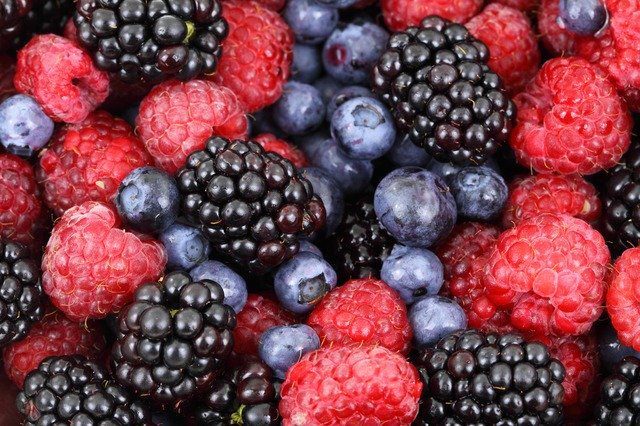

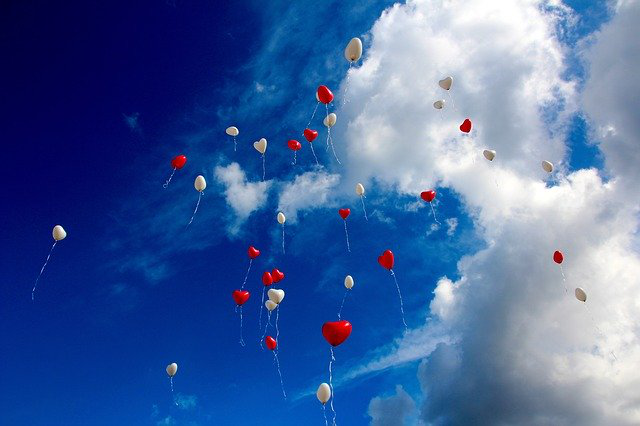

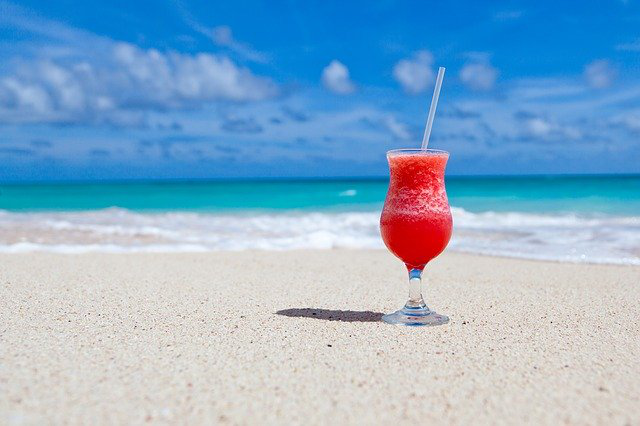

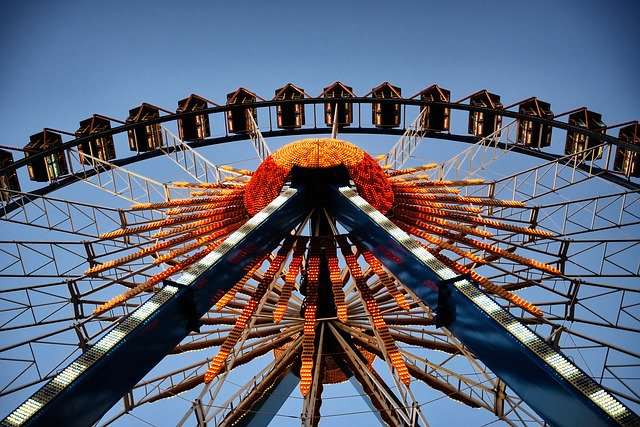

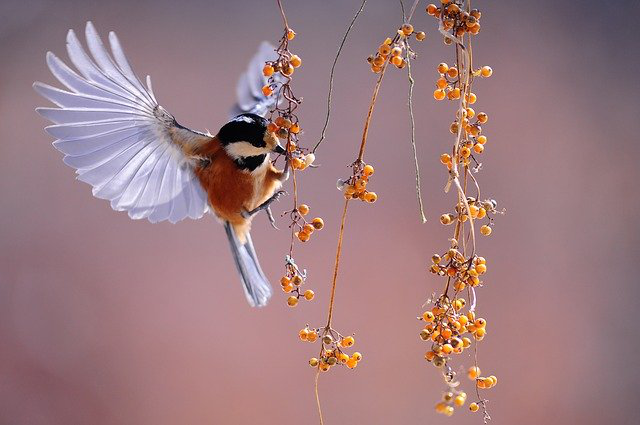

...

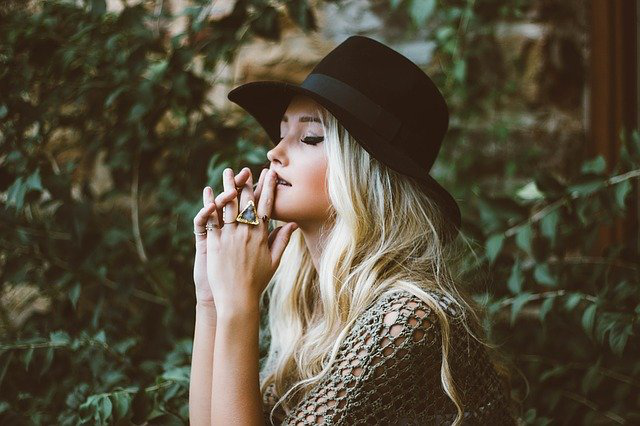

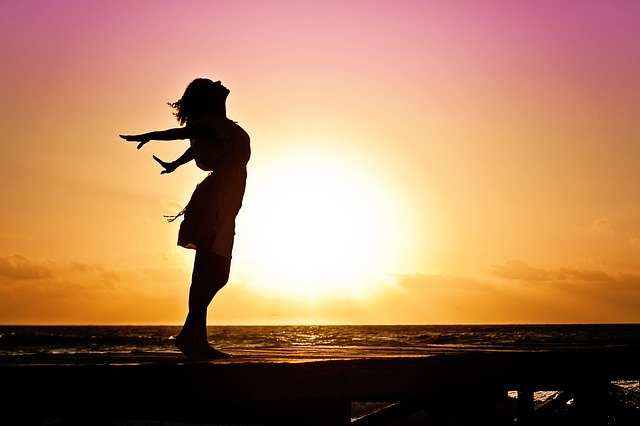

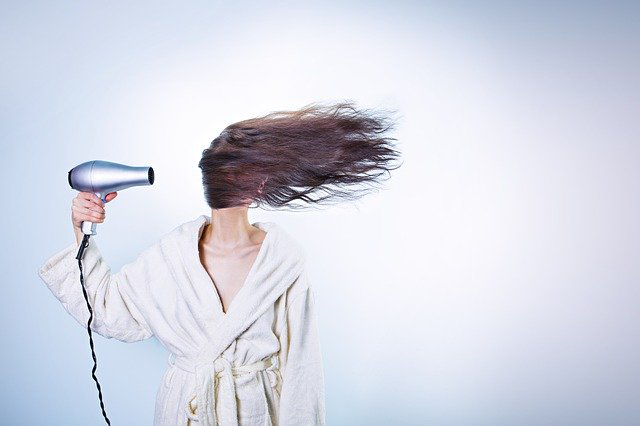

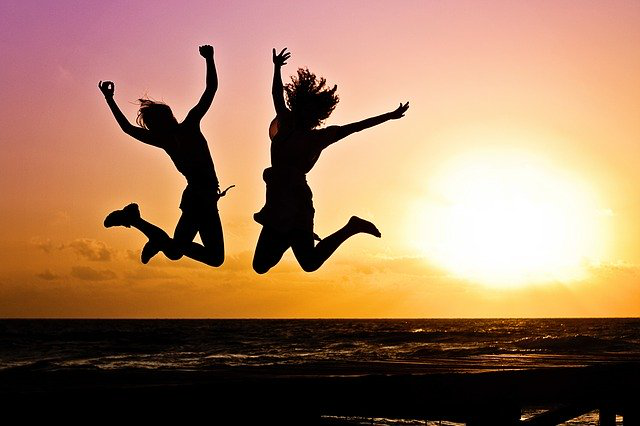

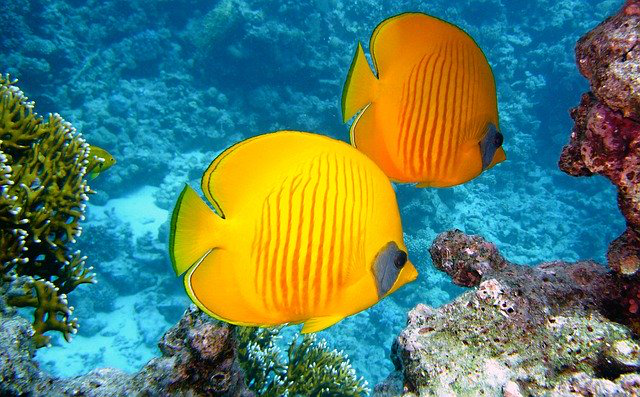

In [4]:
# Mostrando todas as 50 imagens coloridas
for imagem in onlyfiles:
    display(Image(mypath + "\\" + imagem, width=190, unconfined=True))

In [5]:
# Calcula 20% do número de imagens totais, nesse caso, num = 10
num = int(len(onlyfiles)*0.2)

# Cria uma lista aleatóriamente com 20% das imagens totais (10 imagens)
list_of_random_items = random.sample(onlyfiles, num)

# Remove as 10 imagens da primeira lista, restando uma lista com 40 e outra com 10 imagens
for item in list_of_random_items:
	onlyfiles.remove(item)

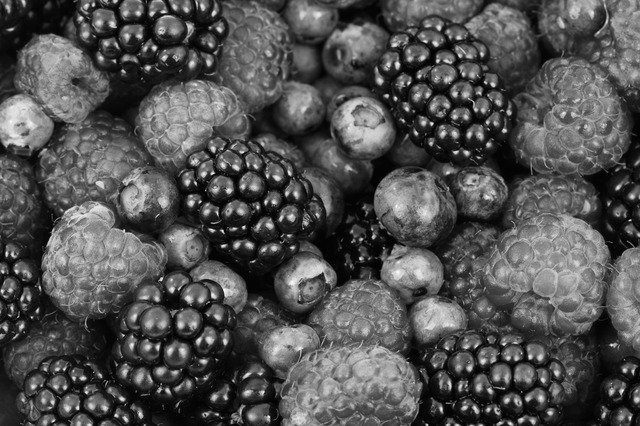

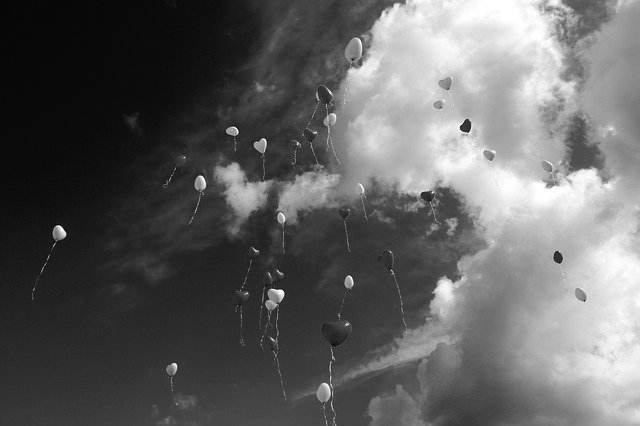

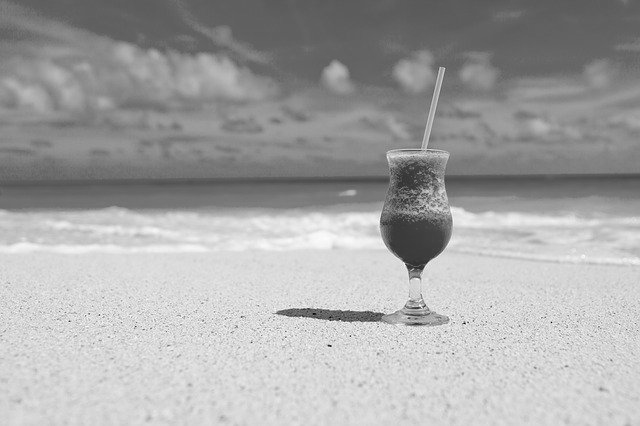

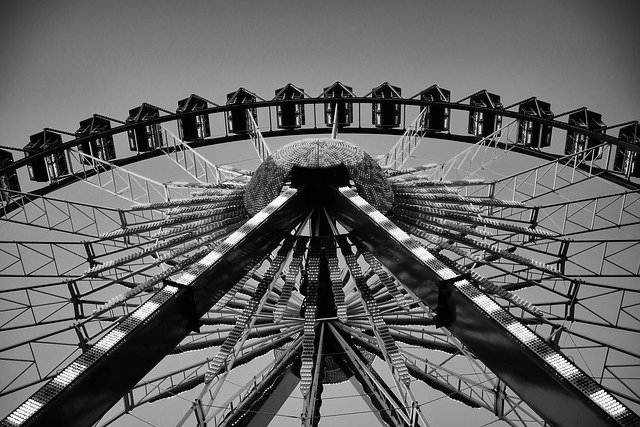

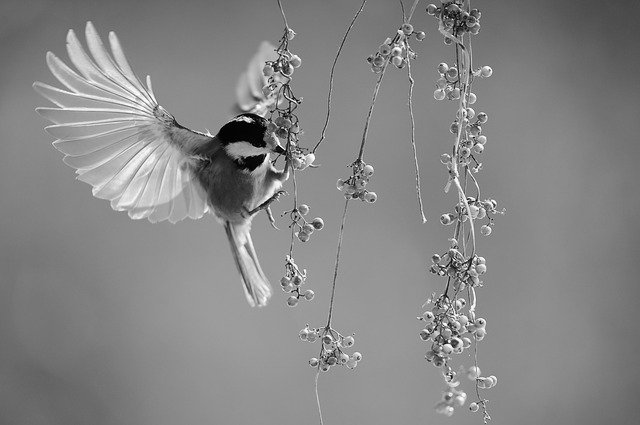

...

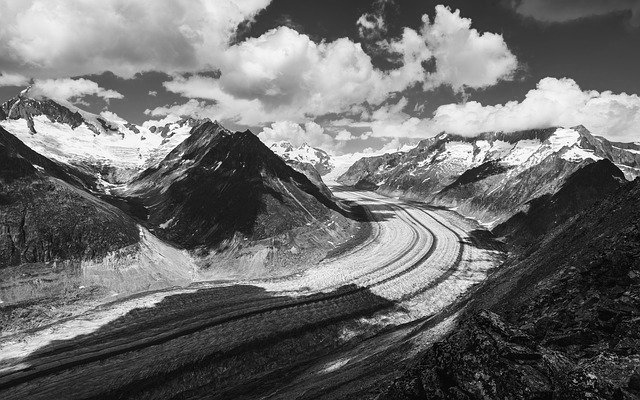

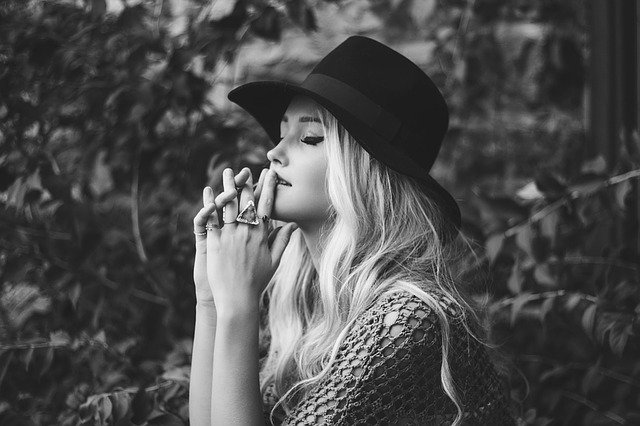

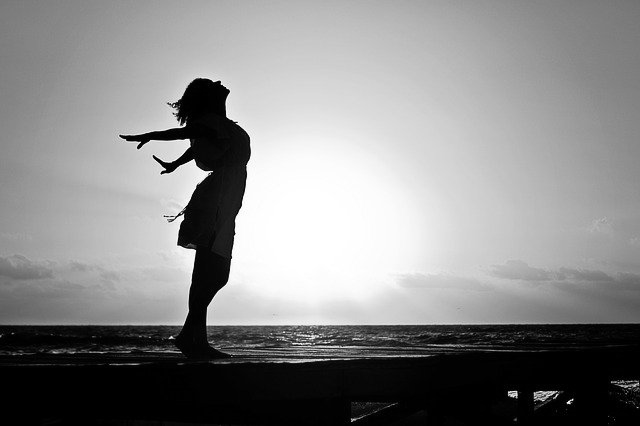

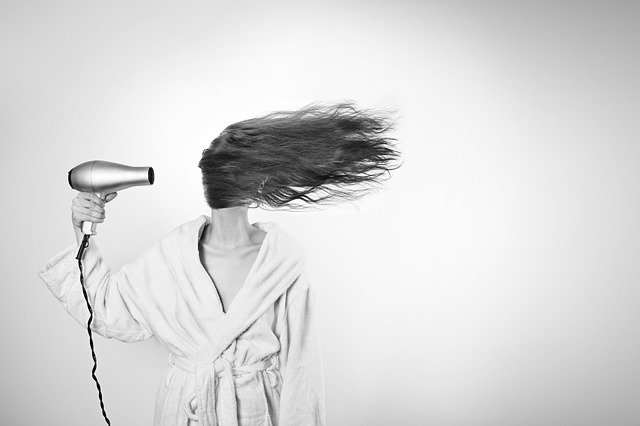

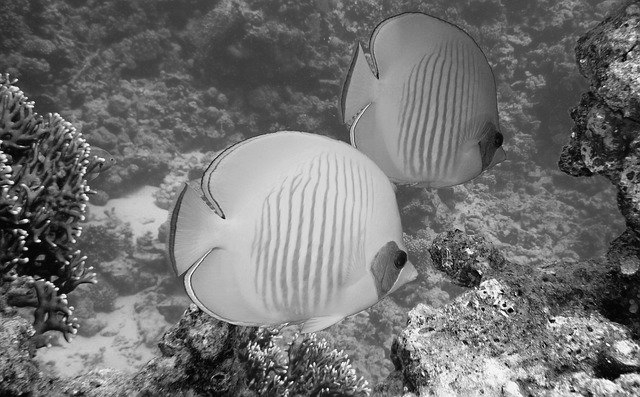

In [6]:
# Diretório para as 40 imagens convertidas em escala cinza
graypath = r'C:\Users\noron\OneDrive\Documentos\natosafe\gray_images'

# Loop for para converter as imagens em escala cinza, salvar no diretório 'gray_images' e mostrá-las
for imagem in onlyfiles:
    img = PILImage.open(mypath + "\\" + imagem).convert('LA')
    img.save(graypath + "\\" + imagem)
    display(Image(graypath + "\\" + imagem, width=190, unconfined=True))

<h3>2. Plotar um histograma dada uma lista de valores em um arquivo .csv<h3>

In [7]:
# Bibliotecas e pacotes utilizados no segundo exercício
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [8]:
# Leitura dos arquivos 'curitiba.csv' e 'foz_do_iguacu.csv'. Ambos contém informações
# de temperatura referente ao mês de Janeiro/2020 para as duas cidades
# Dados: Temperatura Mínima diária, Temperatura Máxima diária e Temperatura Média diária
# além dos dados não utilizados de velocidade e direção do vento

# Criação do DataFrame
df_curitiba = pd.read_csv('curitiba.csv', delimiter = ';')
df_foz = pd.read_csv('foz_do_iguacu.csv', delimiter = ';')

In [9]:
# Labels para cada conjunto plotado
labels = ['Mínima','Mínima Média','Máxima','Máxima Média','Média Mensal']

In [10]:
# Conjunto de dados referente à Cidade de Curitiba
temp_curitiba = [np.min(df_curitiba['TempMin']),
				 round(np.mean(df_curitiba['TempMin']),1),
				 np.max(df_curitiba['TempMax']),
				 round(np.mean(df_curitiba['TempMax']),1),
				 round(np.mean(df_curitiba['TempMedia']),1)]

In [11]:
# Conjunto de dados referente à Cidade de Foz do Iguaçu
temp_foz = [np.min(df_foz['TempMin']),
			round(np.mean(df_foz['TempMin']),1),
			np.max(df_foz['TempMax']),
			round(np.mean(df_foz['TempMax']),1),
			round(np.mean(df_foz['TempMedia']),1)]

In [12]:
# Número de barras no histograma
x = np.arange(len(labels))

# Largura das barras
width = 0.35

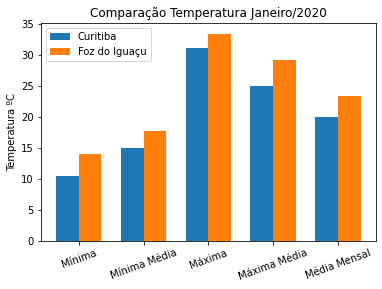

In [13]:
# Criação do frame da figura e suas características
fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, temp_curitiba, width, label='Curitiba')
rects2 = ax.bar(x + width/2, temp_foz, width, label='Foz do Iguaçu')
ax.set_ylabel('Temperatura ºC')
ax.set_title('Comparação Temperatura Janeiro/2020')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=20)
ax.legend()

<h3>3. Fazer uma Regressão Linear utilizando o scikit-learn.<h3>

In [14]:
# Bibliotecas e pacotes utilizados no terceiro exercício
import matplotlib.pyplot as plt
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score

In [15]:
# Utilizou-se os dados do dataset sobre diabetes

# Carregando os dados
diabetes_X, diabetes_y = datasets.load_diabetes(return_X_y=True)

# Utilizando apenas uma informação (característica)
diabetes_X = diabetes_X[:, np.newaxis, 2]

# Separando os dados entre treinamento e teste
diabetes_X_train = diabetes_X[:-20]
diabetes_X_test = diabetes_X[-20:]

# Separando os targets entre treinamento e teste
diabetes_y_train = diabetes_y[:-20]
diabetes_y_test = diabetes_y[-20:]

In [16]:
# Criação do objeto para a Regressão Linear
regr = linear_model.LinearRegression()

# Treinamento do modelo utilizando os dados de treinamento
regr.fit(diabetes_X_train, diabetes_y_train)

# Predições do modelo utilizando os dados de teste
diabetes_y_pred = regr.predict(diabetes_X_test)

In [17]:
# Os coeficientes da Regressão
print('Coeficientes: \n', regr.coef_)
# Erro quadrático médio para os targets do teste e da predição
print('Erro médio quadrático: %.2f' % mean_squared_error(diabetes_y_test, diabetes_y_pred))
# O coeficiente de determinação: quanto mais próximo de 1, melhor.
print('Coeficiente de determinação: %.2f' % r2_score(diabetes_y_test, diabetes_y_pred))

Coeficientes: 
 [938.23786125]
Erro médio quadrático: 2548.07
Coeficiente de determinação: 0.47


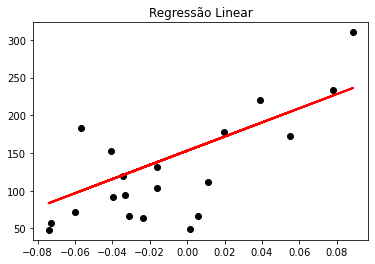

In [18]:
# Gráfico com os pontos dos dados de teste e reta resultado da Regressão Linear
plt.scatter(diabetes_X_test, diabetes_y_test,  color='black')
plt.plot(diabetes_X_test, diabetes_y_pred, color='red', linewidth=2)
plt.title('Regressão Linear')
plt.show()